<a href="https://colab.research.google.com/github/nandinib1999/CNN_cifar10_classification/blob/master/CustomObjectDetectionAPI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [26]:
!apt-get install protobuf-compiler python-pil python-lxml python-tk

Reading package lists... Done
Building dependency tree       
Reading state information... Done
python-pil is already the newest version (5.1.0-1).
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
python-lxml is already the newest version (4.2.1-1ubuntu0.1).
python-tk is already the newest version (2.7.16-2~18.04).
0 upgraded, 0 newly installed, 0 to remove and 8 not upgraded.


In [27]:
!pip install Cython

In [0]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 43, done.
remote: Counting objects: 100% (43/43), done.
remote: Compressing objects: 100% (40/40), done.
remote: Total 31368 (delta 15), reused 21 (delta 3), pack-reused 31325
Receiving objects: 100% (31368/31368), 510.81 MiB | 34.86 MiB/s, done.
Resolving deltas: 100% (19765/19765), done.
Checking out files: 100% (3114/3114), done.


In [28]:
%cd /content/models/research

/content/models/research


In [0]:
!protoc object_detection/protos/*.proto --python_out=.

In [30]:
%set_env PYTHONPATH=/content/models/research:/content/models/research/slim

env: PYTHONPATH=/content/models/research:/content/models/research/slim


In [31]:
!python object_detection/builders/model_builder_test.py

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



Running tests under Python 3.6.8: /usr/bin/python3
[ RUN      ] ModelBuilderTest.test_create_faster_rcnn_model_from_config_with_example_miner
[       OK ] ModelBuilderTest.test_create_faster_rcnn_model_from_config_with_example_miner
[ RUN      ] ModelBuilderTest.test_create_faster_rcnn_models_from_config_faster_rcnn_with_matmul
[       OK ] ModelBuilderTest.test_create_faster_rcnn_models_from_config_faster_rcnn_with_matmul
[ RUN      ] ModelBuilderTest.test_create_faster_rcnn_models_from_config_faster_rcnn_without_matmul
[       OK ] ModelBuilderTest.test_create_faster_rcnn_models_from_config_faster_rcnn_without_matmul
[ RUN  

In [32]:
!python object_detection/generate_TFRecords.py --csv_input=object_detection/images/train_labels.csv --image_dir=object_detection/images/train --output_path=object_detection/train.record
!python object_detection/generate_TFRecords.py --csv_input=object_detection/images/test_labels.csv --image_dir=object_detection/images/test --output_path=object_detection/test.record



W1012 17:46:13.149484 139856508032896 module_wrapper.py:139] From object_detection/generate_TFRecords.py:79: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W1012 17:46:13.231111 139856508032896 module_wrapper.py:139] From object_detection/generate_TFRecords.py:38: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/models/research/object_detection/train.record


W1012 17:46:17.388367 140651683026816 module_wrapper.py:139] From object_detection/generate_TFRecords.py:79: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W1012 17:46:17.418196 140651683026816 module_wrapper.py:139] From object_detection/generate_TFRecords.py:38: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/models/research/object_detection/test.record


In [33]:
%cd object_detection

/content/models/research/object_detection


In [80]:
!python model_main.py --logtostderr --train_dir=training/ --pipeline_config_path=training/faster_rcnn_inception_v2_pets.config --model_dir=training/

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.





W1012 19:23:13.873231 140004553721728 module_wrapper.py:139] From /content/models/research/object_detection/utils/config_util.py:102: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.


W1012 19:23:13.876926 140004553721728 module_wrapper.py:139] From /content/models/research/object_detection/model_lib.py:616: The name tf.logging.warning is deprecated. Please use tf.compat.v1.logging.warning instead.

W1012 19:23:13.877077 140004553721728 model_lib.py:617] Forced number of epochs for all eval validations to be 1.

W1012 19:23:13.877216 140004553721728 module_wrapper.py:139] From /content/models/res

In [82]:
!python export_inference_graph.py --input_type image_tensor --pipeline_config_path training/faster_rcnn_inception_v2_pets.config --trained_checkpoint_prefix training/model.ckpt-4013 --output_directory inference_graph

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.





W1012 19:38:17.886625 140510482139008 module_wrapper.py:139] From export_inference_graph.py:145: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.


W1012 19:38:17.893841 140510482139008 module_wrapper.py:139] From /content/models/research/object_detection/exporter.py:381: The name tf.gfile.MakeDirs is deprecated. Please use tf.io.gfile.makedirs instead.


W1012 19:38:17.894331 140510482139008 module_wrapper.py:139] From /content/models/research/object_detection/exporter.py:113: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.


W1012 19:38:17.949964 1405104821390

/content/models/research/object_detection
Image::  /content/models/research/object_detection/images/test/20191005_203743326_iOS.jpg


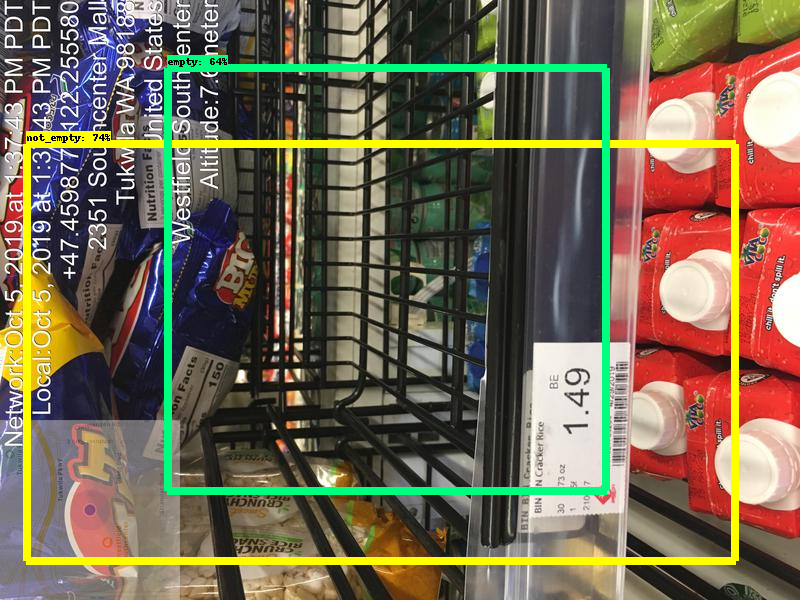

Image::  /content/models/research/object_detection/images/test/20191005_214241012_iOS.jpg


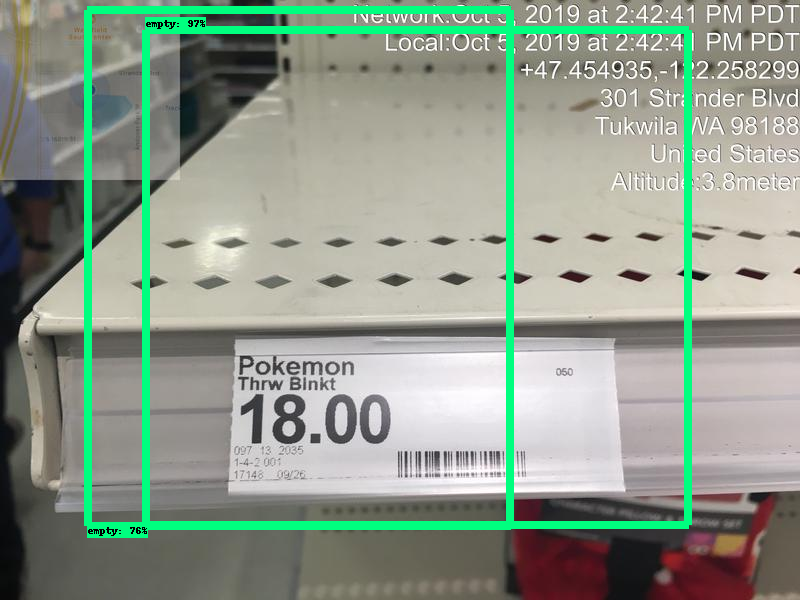

Image::  /content/models/research/object_detection/images/test/20191005_212715863_iOS.jpg


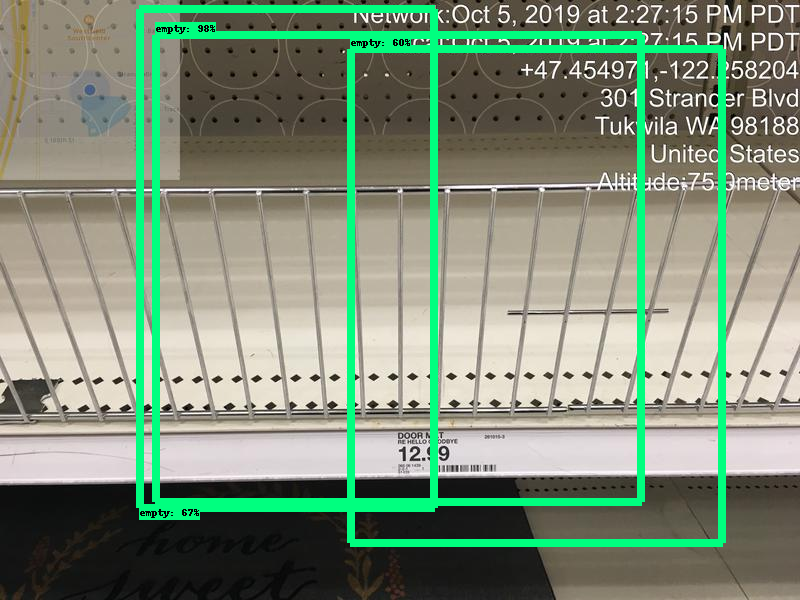

Image::  /content/models/research/object_detection/images/test/20191005_215632380_iOS.jpg


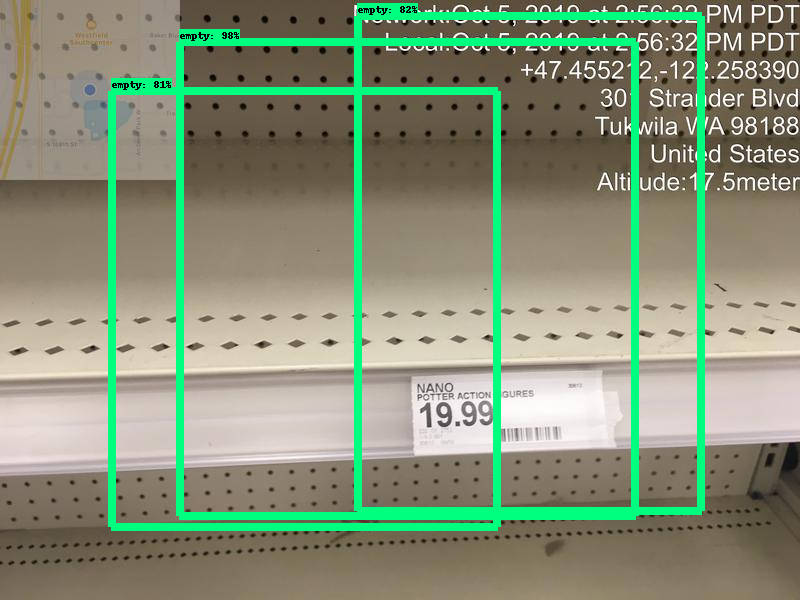

Image::  /content/models/research/object_detection/images/test/20191005_215624640_iOS.jpg


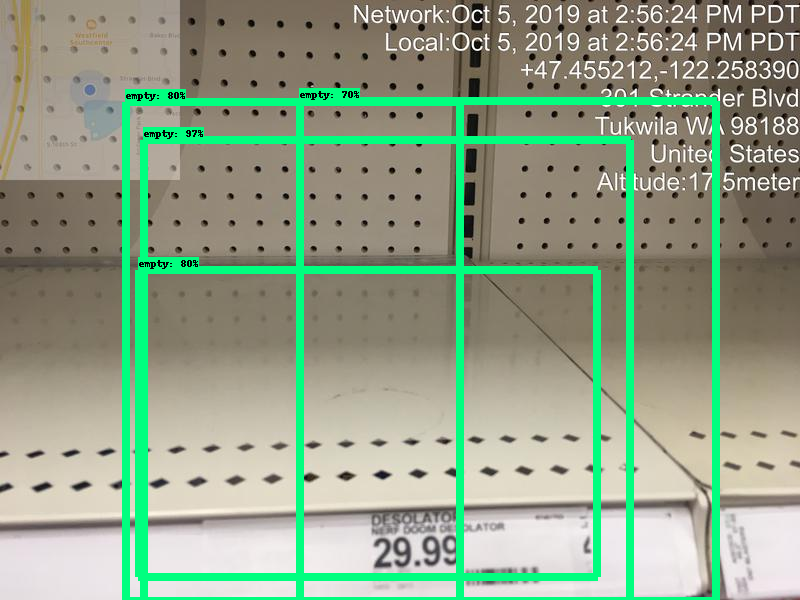

Image::  /content/models/research/object_detection/images/test/20191005_214546573_iOS.jpg


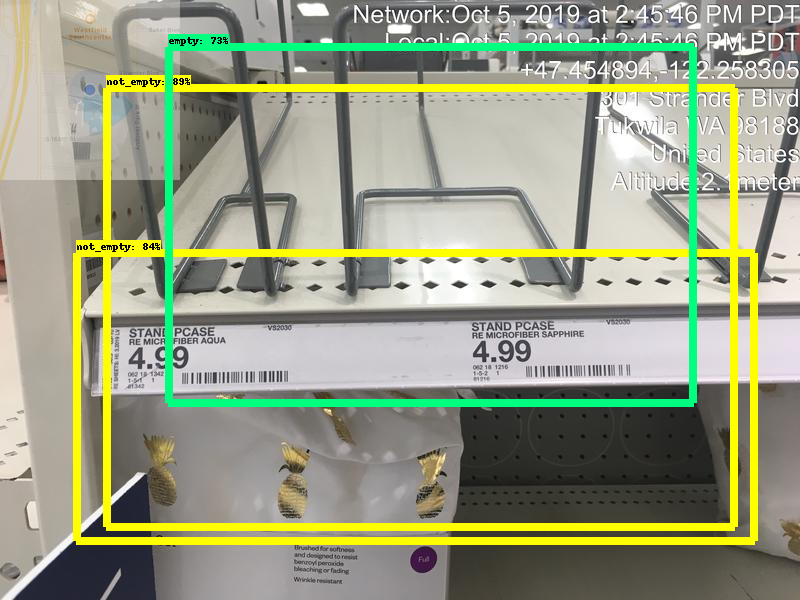

Image::  /content/models/research/object_detection/images/test/20191005_214233069_iOS.jpg


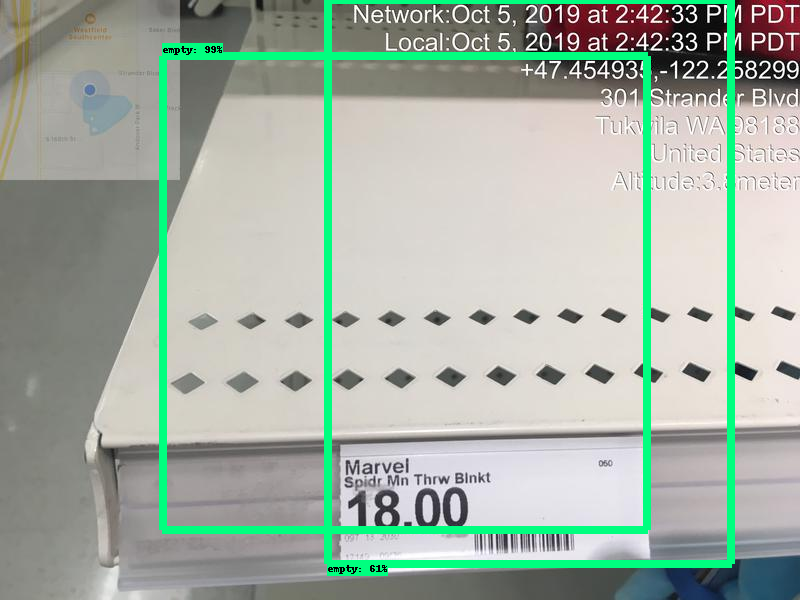

Image::  /content/models/research/object_detection/images/test/20191005_214137311_iOS.jpg


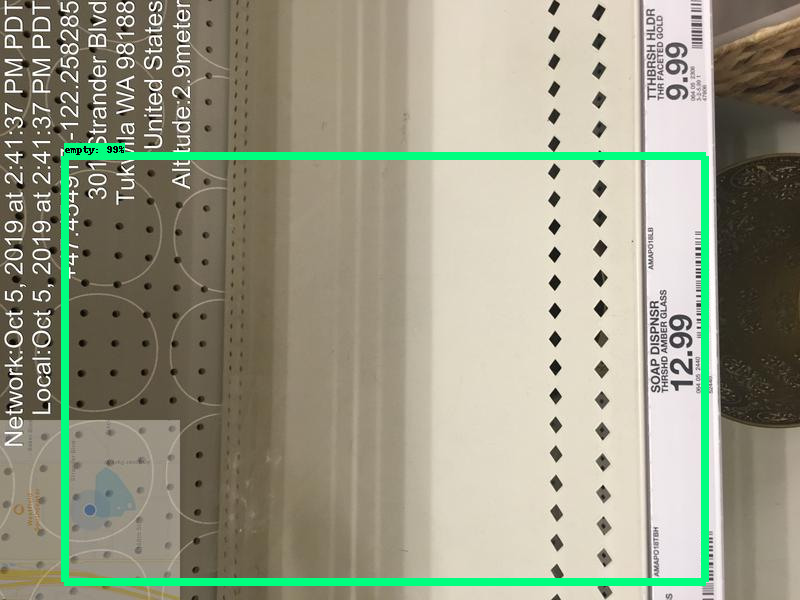

Image::  /content/models/research/object_detection/images/test/20191005_214146300_iOS.jpg


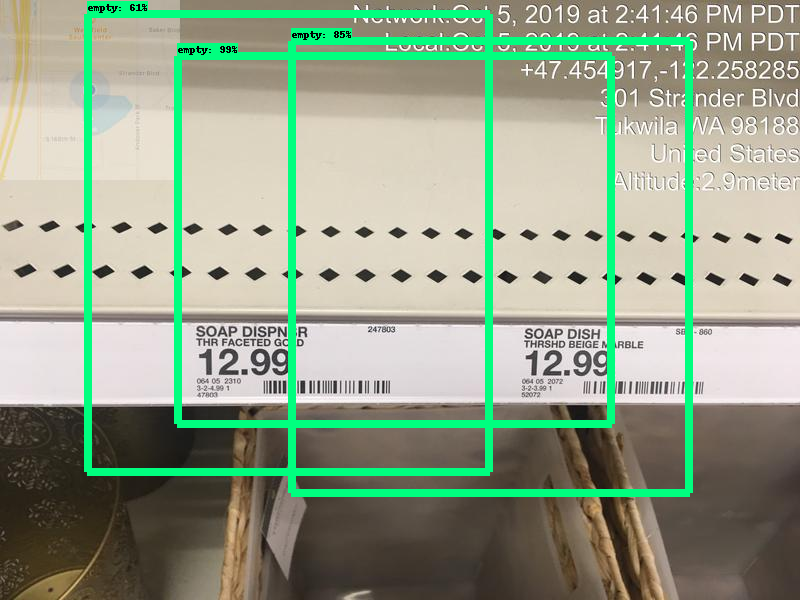

Image::  /content/models/research/object_detection/images/test/20191005_204108770_iOS.jpg


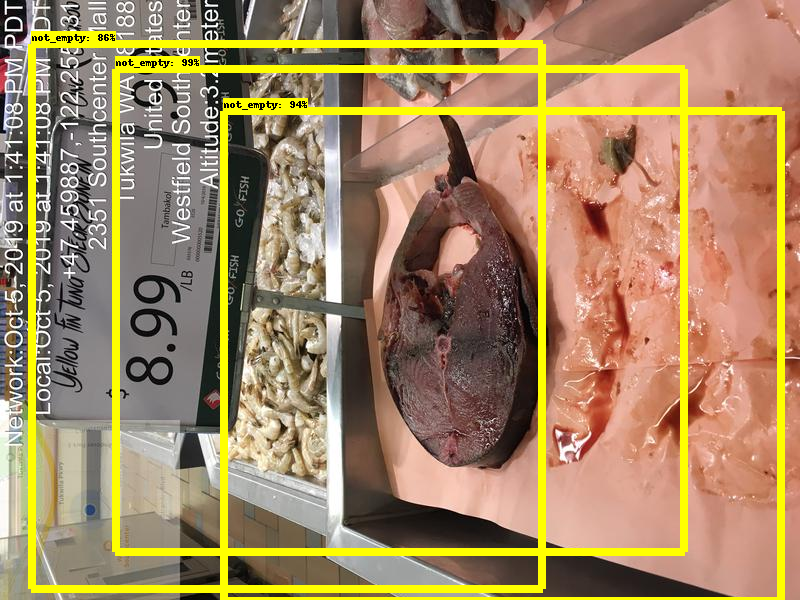

Image::  /content/models/research/object_detection/images/test/20191005_215610901_iOS.jpg


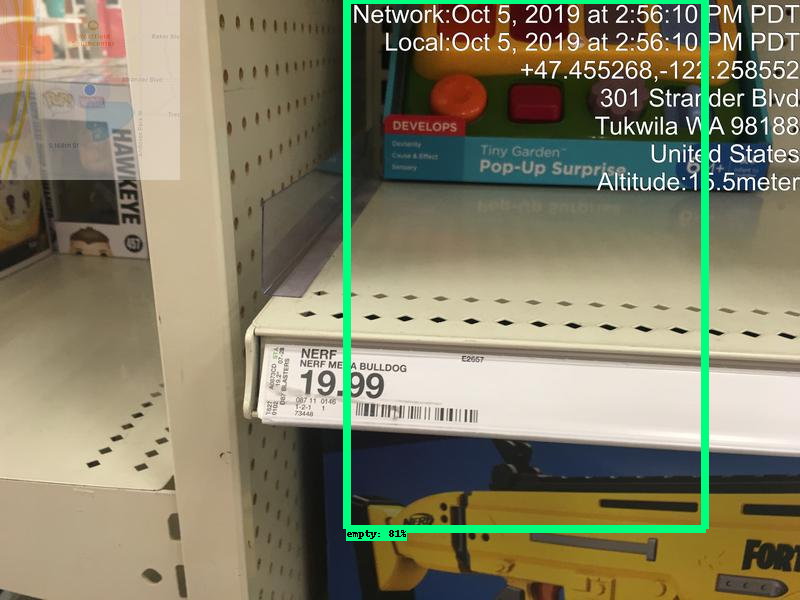

Image::  /content/models/research/object_detection/images/test/20191005_220145863_iOS.jpg


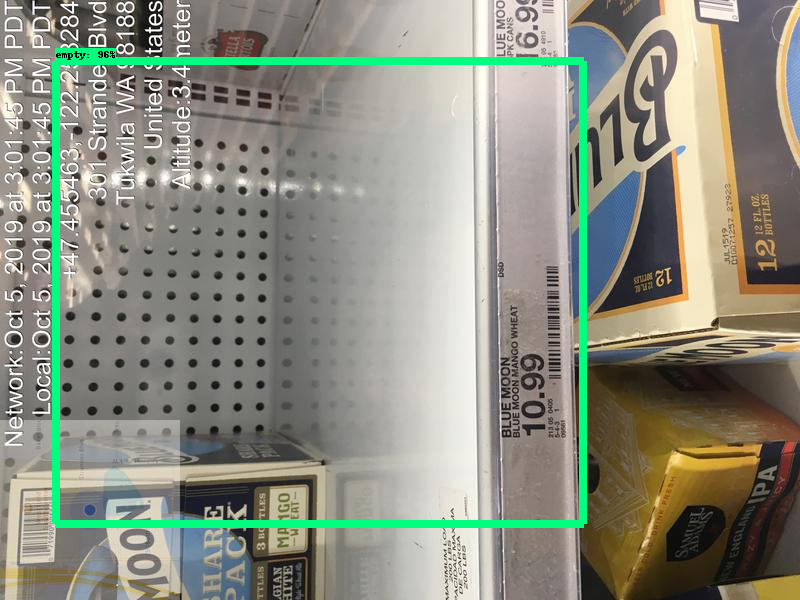

Image::  /content/models/research/object_detection/images/test/20191005_220439412_iOS.jpg


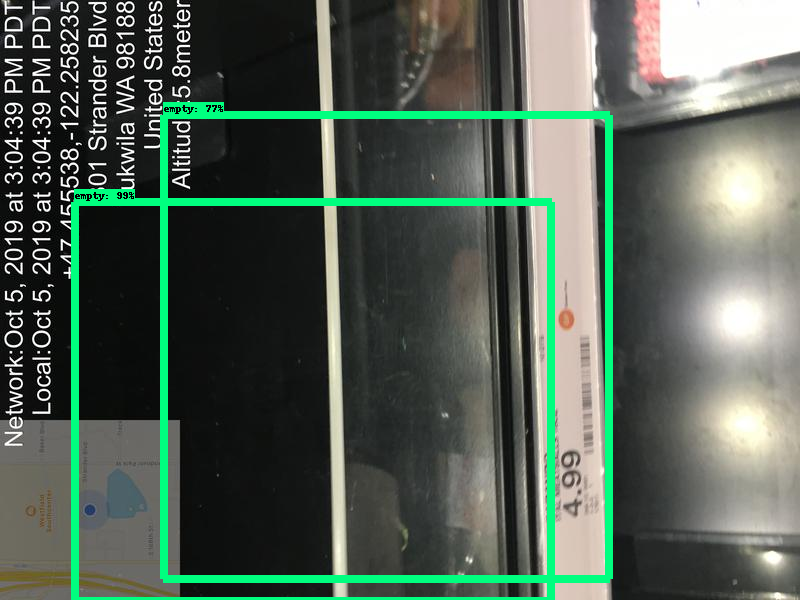

Image::  /content/models/research/object_detection/images/test/20191005_214139587_iOS.jpg


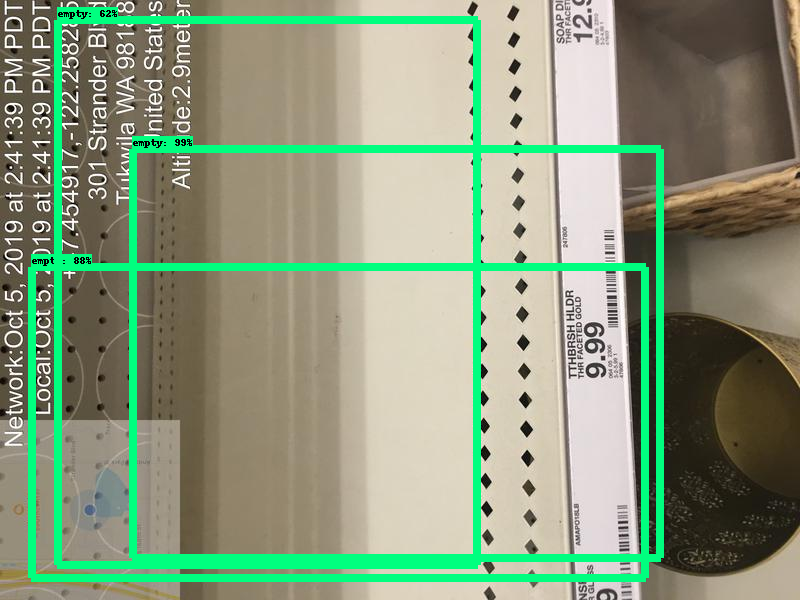

Image::  /content/models/research/object_detection/images/test/20191005_214712491_iOS.jpg


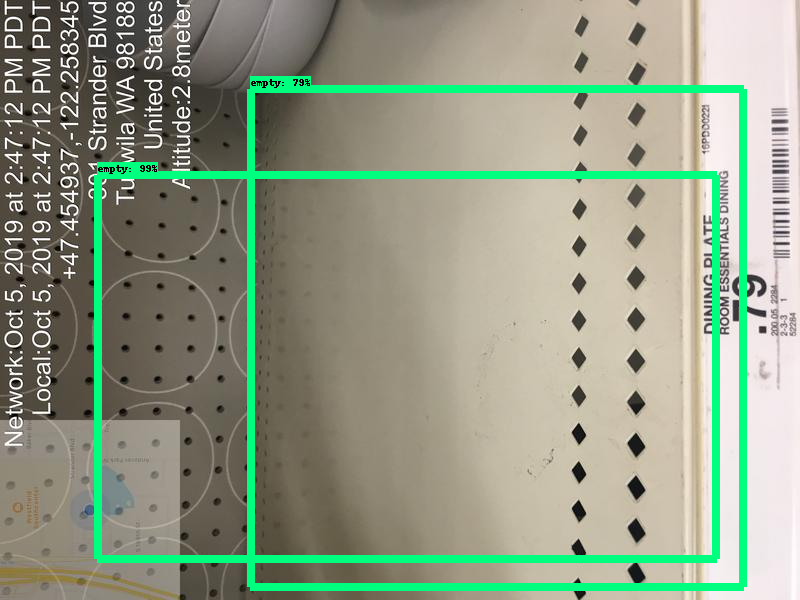

Image::  /content/models/research/object_detection/images/test/20191005_214435320_iOS.jpg


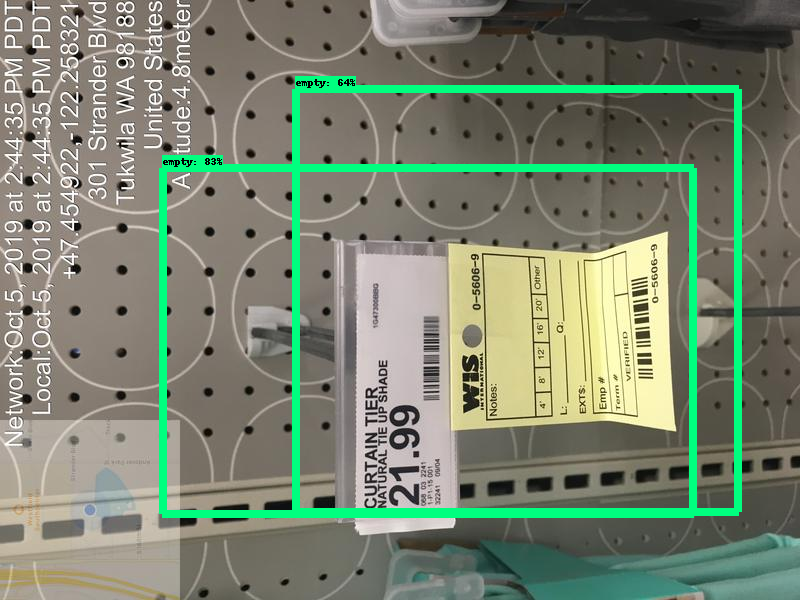

Image::  /content/models/research/object_detection/images/test/20191005_215643216_iOS.jpg


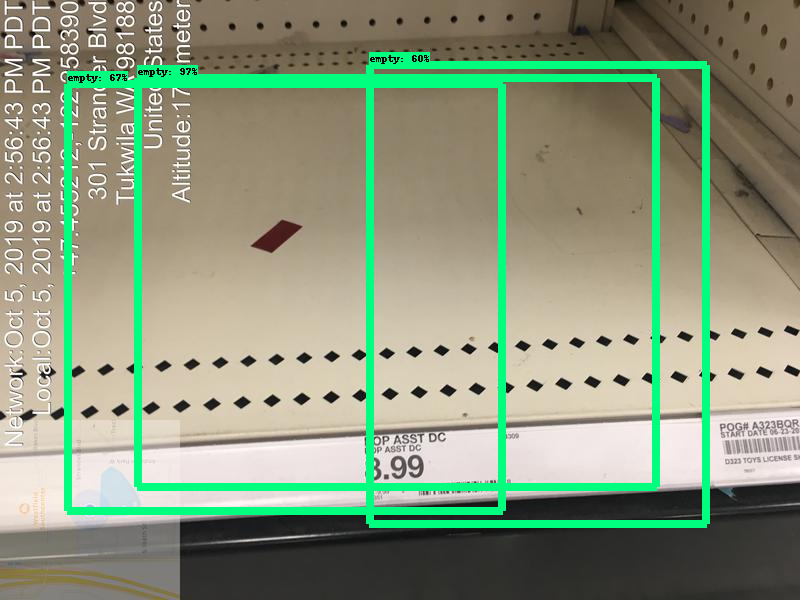

Image::  /content/models/research/object_detection/images/test/20191005_215532314_iOS.jpg


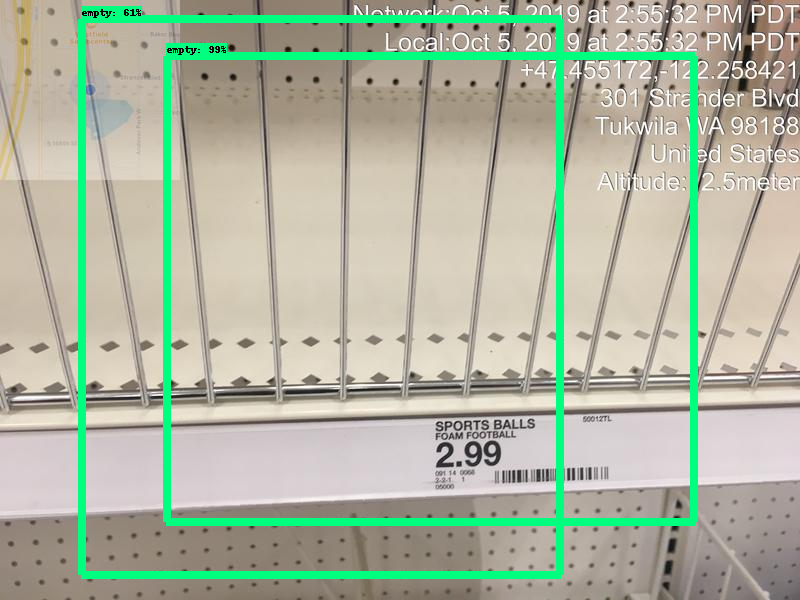

Image::  /content/models/research/object_detection/images/test/20191005_214309191_iOS.jpg


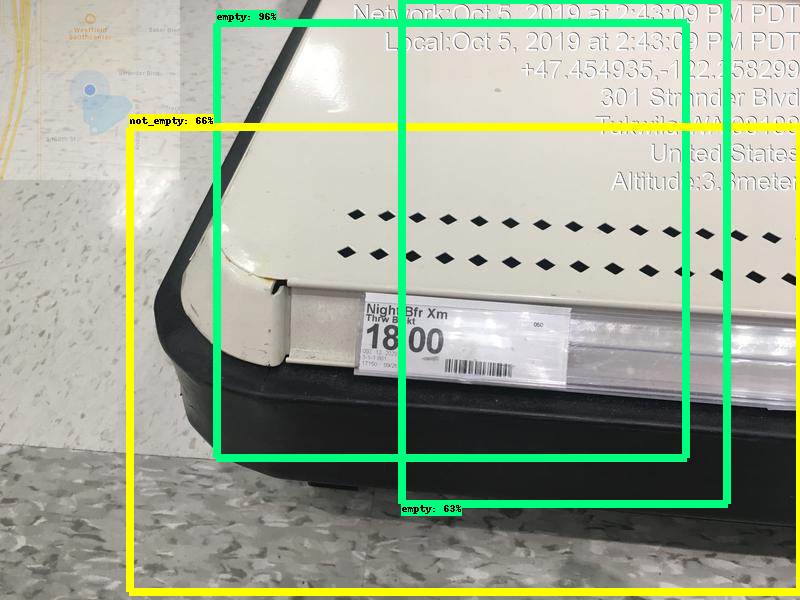

Image::  /content/models/research/object_detection/images/test/20191005_212816497_iOS.jpg


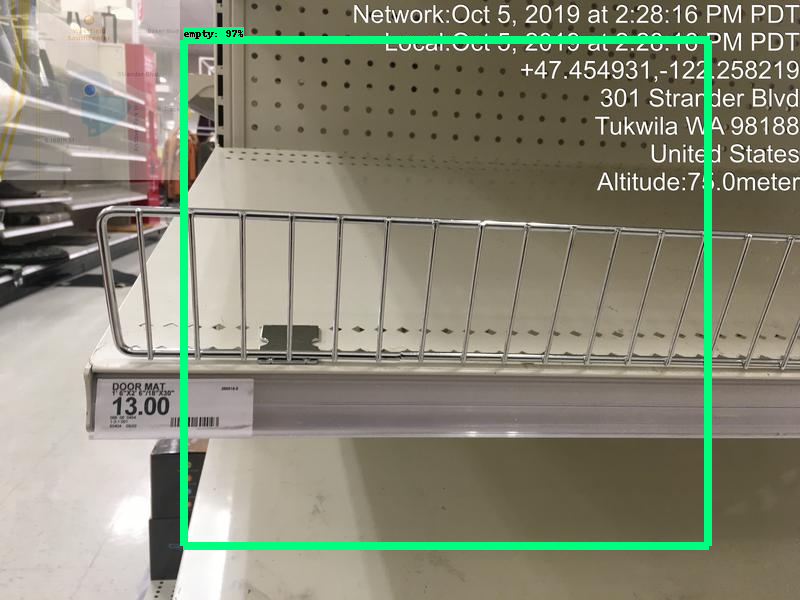

Image::  /content/models/research/object_detection/images/test/20191005_204748045_iOS.jpg


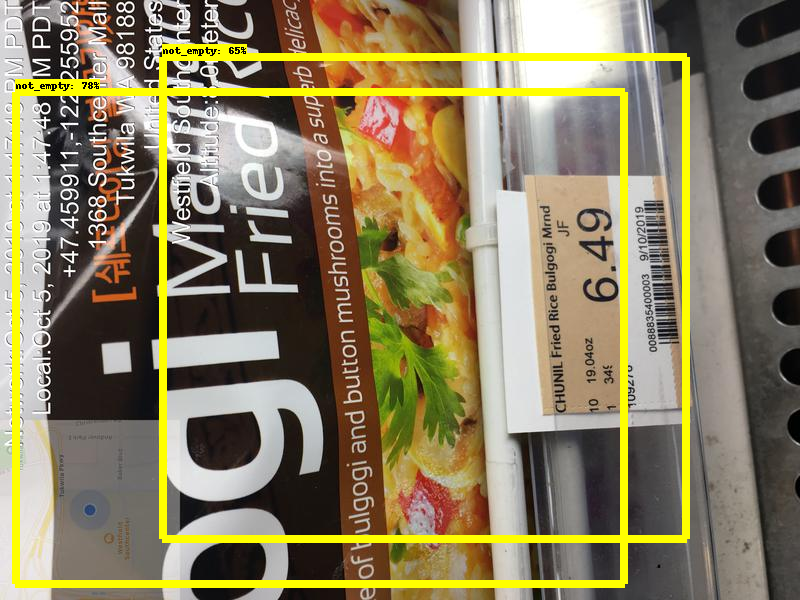

Image::  /content/models/research/object_detection/images/test/20191005_204349046_iOS.jpg


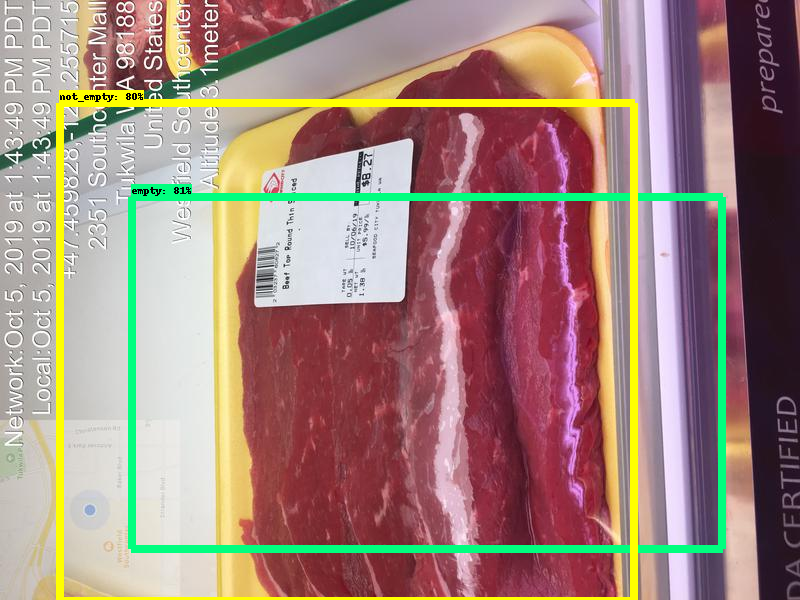

Image::  /content/models/research/object_detection/images/test/20191005_214503006_iOS.jpg


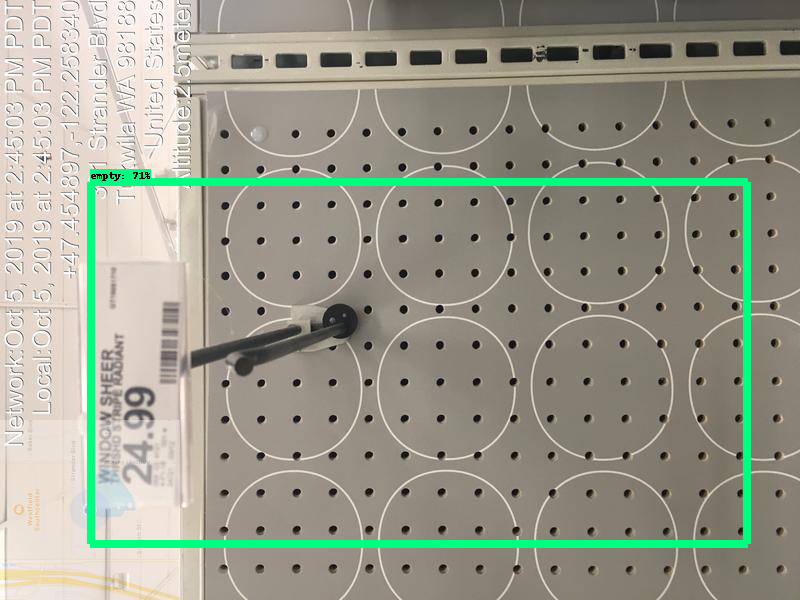

Image::  /content/models/research/object_detection/images/test/20191006_032448179_iOS.jpg


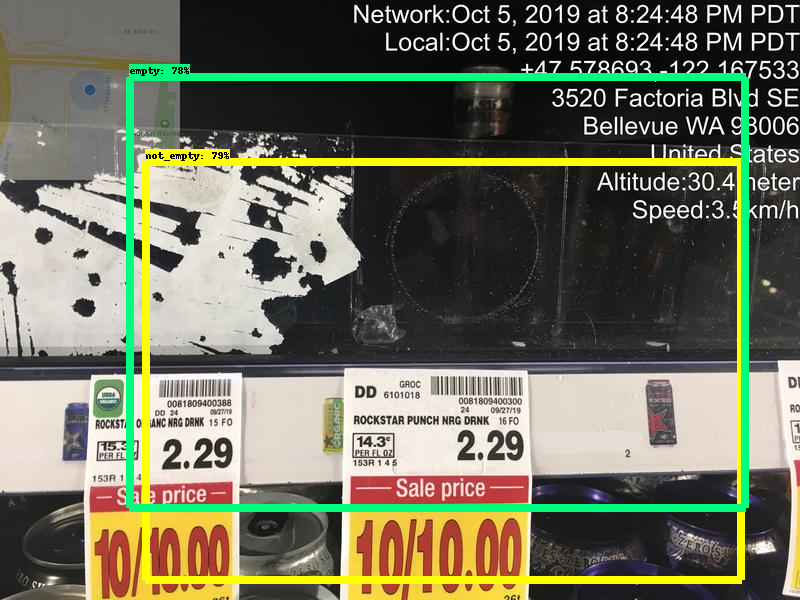

Image::  /content/models/research/object_detection/images/test/20191005_205949815_iOS.jpg


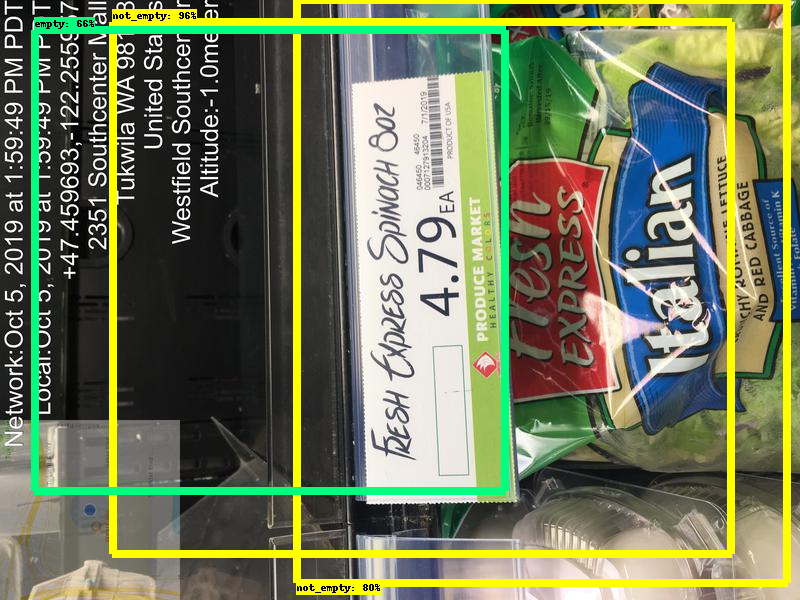

Image::  /content/models/research/object_detection/images/test/20191005_214955737_iOS.jpg


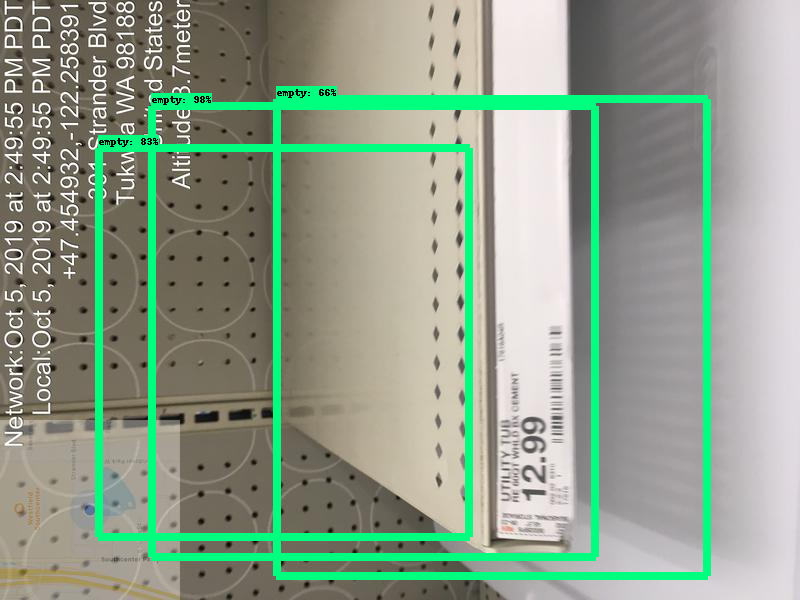

Image::  /content/models/research/object_detection/images/test/20191005_214441315_iOS.jpg


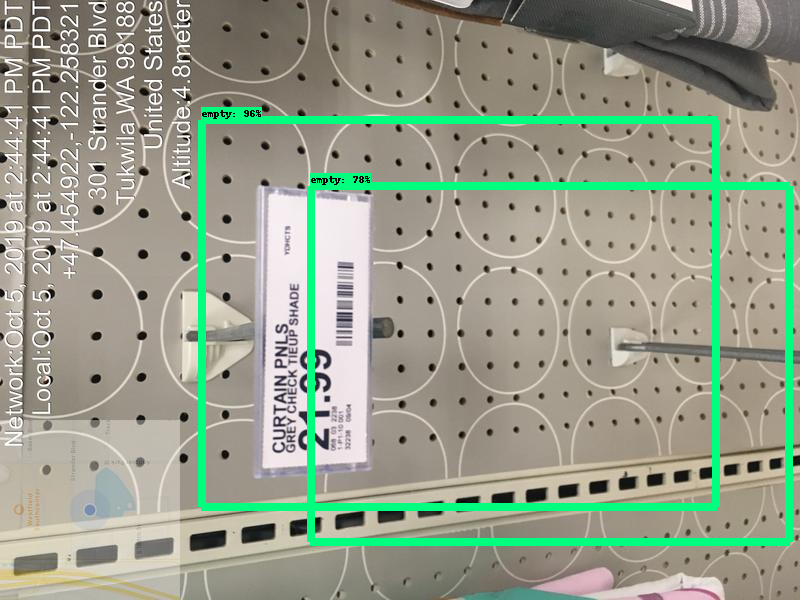

Image::  /content/models/research/object_detection/images/test/20191005_203545494_iOS.jpg


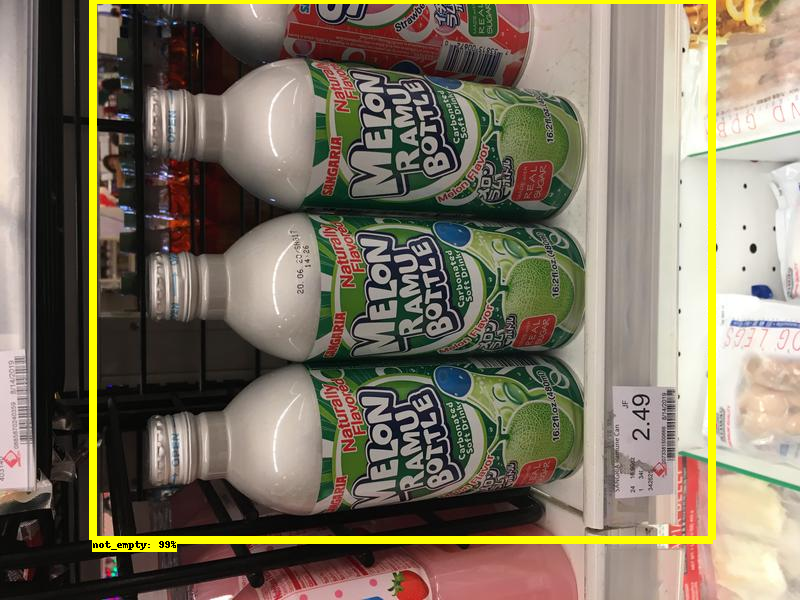

Image::  /content/models/research/object_detection/images/test/20191005_214444594_iOS.jpg


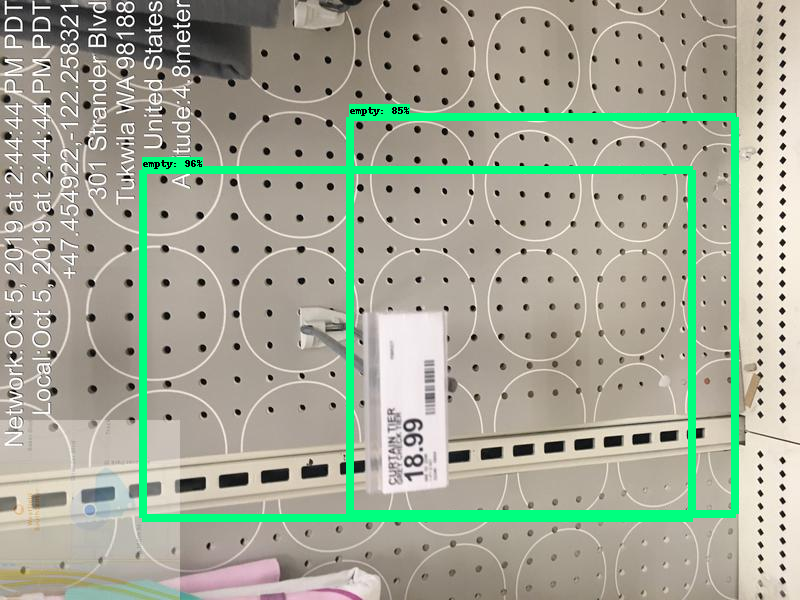

Image::  /content/models/research/object_detection/images/test/20191005_220507838_iOS.jpg


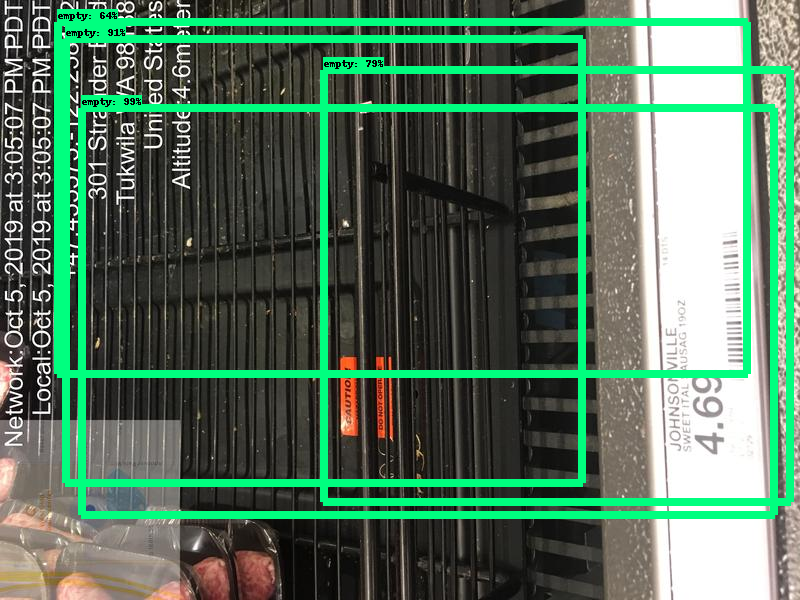

Image::  /content/models/research/object_detection/images/test/20191005_205851765_iOS.jpg


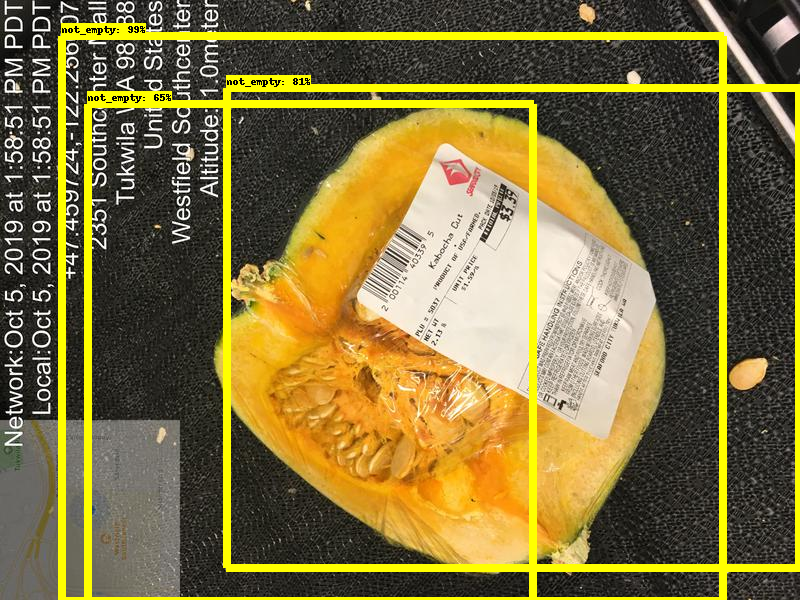

Image::  /content/models/research/object_detection/images/test/20191005_205817235_iOS.jpg


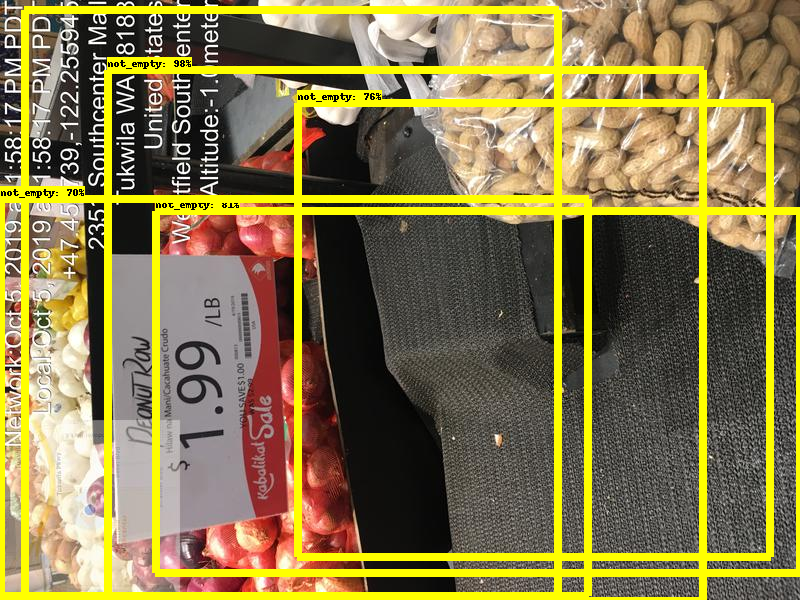

Image::  /content/models/research/object_detection/images/test/20191005_214015903_iOS.jpg


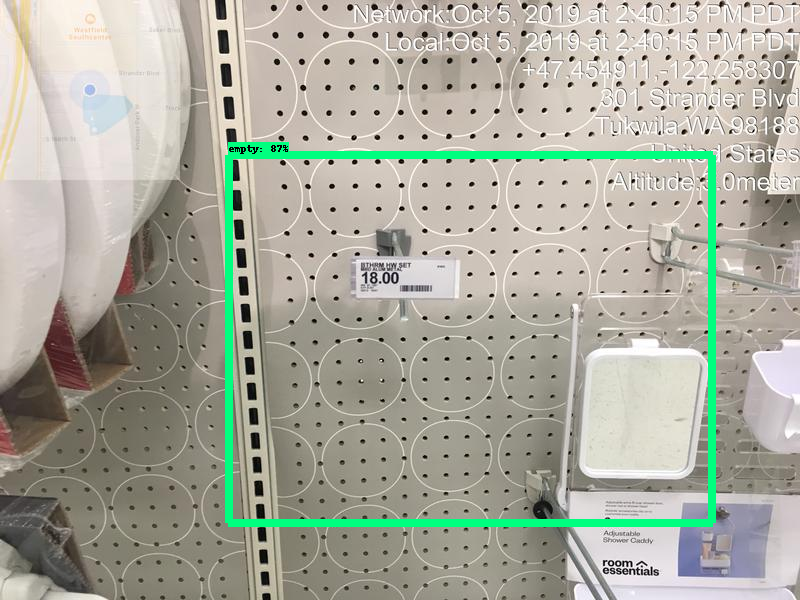

Image::  /content/models/research/object_detection/images/test/20191005_214002108_iOS.jpg


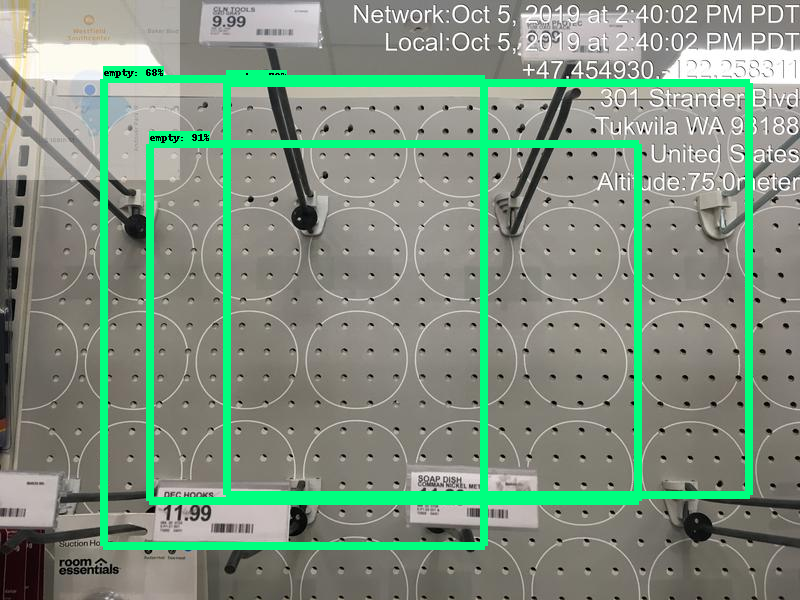

Image::  /content/models/research/object_detection/images/test/20191005_215635390_iOS.jpg


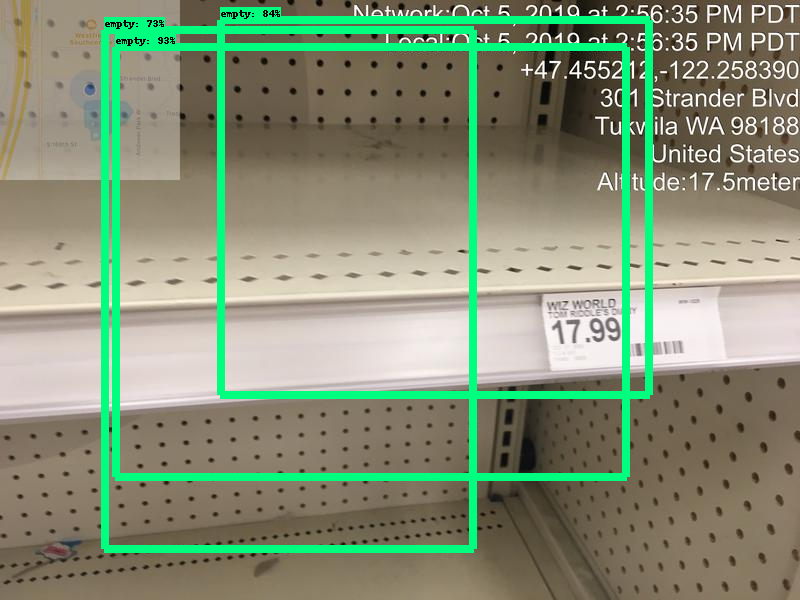

Image::  /content/models/research/object_detection/images/test/20191005_203914627_iOS.jpg


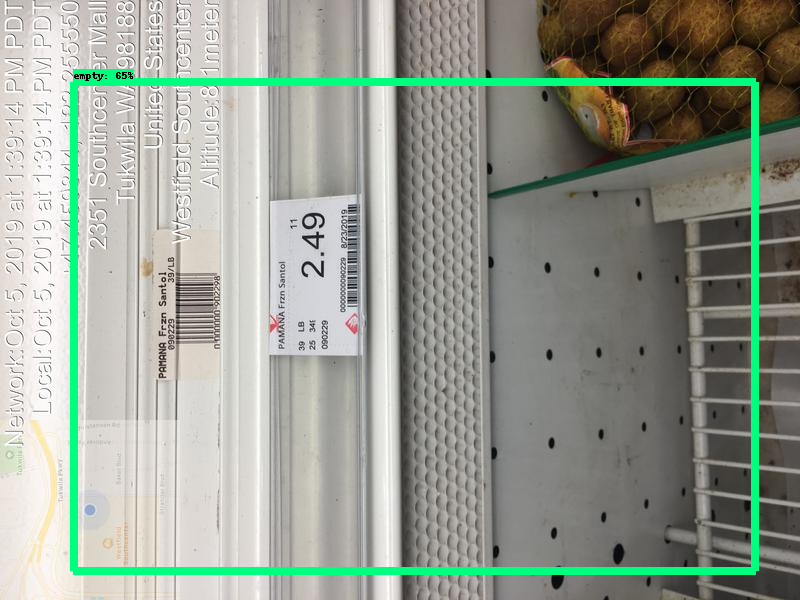

In [83]:
######## Image Object Detection Using Tensorflow-trained Classifier #########
#
# Author: Evan Juras
# Date: 1/15/18
# Description: 
# This program uses a TensorFlow-trained neural network to perform object detection.
# It loads the classifier and uses it to perform object detection on an image.
# It draws boxes, scores, and labels around the objects of interest in the image.

## Some of the code is copied from Google's example at
## https://github.com/tensorflow/models/blob/master/research/object_detection/object_detection_tutorial.ipynb

## and some is copied from Dat Tran's example at
## https://github.com/datitran/object_detector_app/blob/master/object_detection_app.py

## but I changed it to make it more understandable to me.

# Import packages
import os
import cv2
import numpy as np
import tensorflow as tf
import sys
from google.colab.patches import cv2_imshow

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")

# Import utilites
from utils import label_map_util
from utils import visualization_utils as vis_util

# Name of the directory containing the object detection module we're using
MODEL_NAME = 'inference_graph'
TEST_IMAGE_DIR = 'images/test'

# Grab path to current working directory
CWD_PATH = os.getcwd()
print(CWD_PATH)

# Path to frozen detection graph .pb file, which contains the model that is used
# for object detection.
PATH_TO_CKPT = os.path.join(CWD_PATH,MODEL_NAME,'frozen_inference_graph.pb')

# Path to label map file
PATH_TO_LABELS = os.path.join(CWD_PATH,'training','labelmap.pbtxt')

for IMAGE_NAME in os.listdir(TEST_IMAGE_DIR):
  if IMAGE_NAME.split('.')[-1] in ['jpg', 'png', 'jpeg']:
  # Path to image
    PATH_TO_IMAGE = os.path.join(CWD_PATH,TEST_IMAGE_DIR, IMAGE_NAME)
    print("Image:: ", PATH_TO_IMAGE)

    # Number of classes the object detector can identify
    NUM_CLASSES = 2

    # Load the label map.
    # Label maps map indices to category names, so that when our convolution
    # network predicts `5`, we know that this corresponds to `king`.
    # Here we use internal utility functions, but anything that returns a
    # dictionary mapping integers to appropriate string labels would be fine
    label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
    categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)

    # Load the Tensorflow model into memory.
    detection_graph = tf.Graph()
    with detection_graph.as_default():
        od_graph_def = tf.GraphDef()
        with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
            serialized_graph = fid.read()
            od_graph_def.ParseFromString(serialized_graph)
            tf.import_graph_def(od_graph_def, name='')

        sess = tf.Session(graph=detection_graph)

    # Define input and output tensors (i.e. data) for the object detection classifier

    # Input tensor is the image
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')

    # Output tensors are the detection boxes, scores, and classes
    # Each box represents a part of the image where a particular object was detected
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')

    # Each score represents level of confidence for each of the objects.
    # The score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')

    # Number of objects detected
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')

    # Load image using OpenCV and
    # expand image dimensions to have shape: [1, None, None, 3]
    # i.e. a single-column array, where each item in the column has the pixel RGB value
    image = cv2.imread(PATH_TO_IMAGE)
    image_expanded = np.expand_dims(image, axis=0)

    # Perform the actual detection by running the model with the image as input
    (boxes, scores, classes, num) = sess.run(
        [detection_boxes, detection_scores, detection_classes, num_detections],
        feed_dict={image_tensor: image_expanded})

    # Draw the results of the detection (aka 'visulaize the results')

    vis_util.visualize_boxes_and_labels_on_image_array(
        image,
        np.squeeze(boxes),
        np.squeeze(classes).astype(np.int32),
        np.squeeze(scores),
        category_index,
        use_normalized_coordinates=True,
        line_thickness=8,
        min_score_thresh=0.60)

    # All the results have been drawn on image. Now display the image.
    cv2_imshow(image)

# Press any key to close the image
cv2.waitKey(0)

# Clean up
cv2.destroyAllWindows()

In [78]:
!python eval_util.py --logtostderr --pipeline_config_path=training/faster_rcnn_inception_v2_pets.config --checkpoint_dir=training/ --eval_dir=eval/

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

